# 1. 이미지 3장 만들기

In [2]:
import os
import urllib
import cv2
import numpy as np
from pixellib.semantic import semantic_segmentation
from matplotlib import pyplot as plt

(2160, 2160, 3)


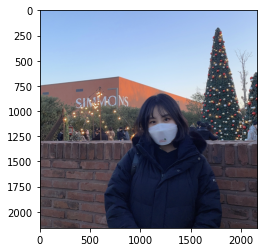

(1440, 1440, 3)


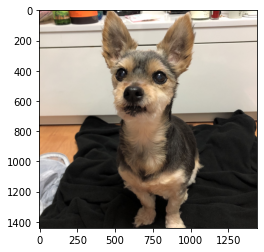

(1281, 1920, 3)


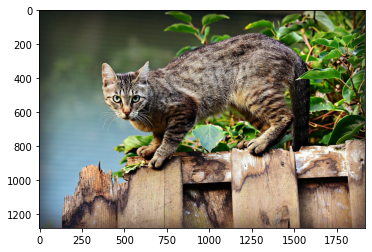

In [3]:
# 본인이 선택한 이미지의 경로에 맞게 바꿔 주세요.
me_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/me.jpg'  
me_orig = cv2.imread(me_path)
dog_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/samsuni.jpeg'  
dog_orig = cv2.imread(dog_path) 
cat_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/cat.jpg'  
cat_orig = cv2.imread(cat_path) 

print(me_orig.shape)
plt.imshow(cv2.cvtColor(me_orig, cv2.COLOR_BGR2RGB))
plt.show()
print(dog_orig.shape)
plt.imshow(cv2.cvtColor(dog_orig, cv2.COLOR_BGR2RGB))
plt.show()
print(cat_orig.shape)
plt.imshow(cv2.cvtColor(cat_orig, cv2.COLOR_BGR2RGB))
plt.show()

In [4]:
# 저장할 파일 이름을 결정
model_dir = os.getenv('HOME')+'/aiffel/human_segmentation/models'
model_file = os.path.join(model_dir, 'deeplabv3_xception_tf_dim_ordering_tf_kernels.h5')

# PixelLib가 제공하는 모델의 url
model_url = 'https://github.com/ayoolaolafenwa/PixelLib/releases/download/1.1/deeplabv3_xception_tf_dim_ordering_tf_kernels.h5'

# 다운로드 시작
urllib.request.urlretrieve(model_url, model_file)

# 모델 생성
model = semantic_segmentation()
model.load_pascalvoc_model(model_file)

In [5]:
# 모델에 이미지 입력
segvalues1, output1 = model.segmentAsPascalvoc(me_path)
segvalues2, output2 = model.segmentAsPascalvoc(dog_path)
segvalues3, output3 = model.segmentAsPascalvoc(cat_path)

In [6]:
# 데이터 라벨의 종류
LABEL_NAMES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
]
len(LABEL_NAMES)

21

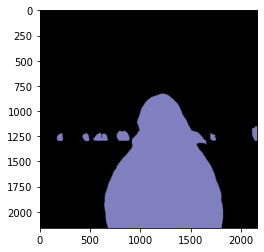

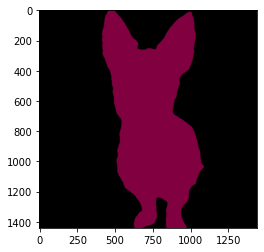

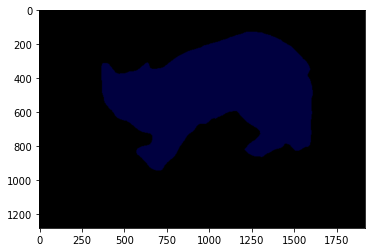

In [7]:
plt.imshow(output1)
plt.show()
plt.imshow(output2)
plt.show()
plt.imshow(output3)
plt.show()

In [8]:
segvalues1
segvalues2
segvalues3

{'class_ids': array([0, 8]),
 'masks': array([[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False]])}

In [9]:
for class_id in segvalues1['class_ids']:
    print(LABEL_NAMES[class_id])
    
for class_id in segvalues2['class_ids']:
    print(LABEL_NAMES[class_id])
    
for class_id in segvalues3['class_ids']:
    print(LABEL_NAMES[class_id])

background
person
background
dog
background
cat


In [10]:
# 아래 코드를 이해하지 않아도 좋습니다
# PixelLib에서 그대로 가져온 코드입니다
# 주목해야 할 것은 생상 코드 결과물이예요!
colormap = np.zeros((256, 3), dtype = int)
ind = np.arange(256, dtype=int)

for shift in reversed(range(8)):
    for channel in range(3):
        colormap[:, channel] |= ((ind >> channel) & 1) << shift
    ind >>= 3

colormap[:20]

array([[  0,   0,   0],
       [128,   0,   0],
       [  0, 128,   0],
       [128, 128,   0],
       [  0,   0, 128],
       [128,   0, 128],
       [  0, 128, 128],
       [128, 128, 128],
       [ 64,   0,   0],
       [192,   0,   0],
       [ 64, 128,   0],
       [192, 128,   0],
       [ 64,   0, 128],
       [192,   0, 128],
       [ 64, 128, 128],
       [192, 128, 128],
       [  0,  64,   0],
       [128,  64,   0],
       [  0, 192,   0],
       [128, 192,   0]])

In [12]:
print(colormap[15])
print(colormap[12])
print(colormap[8])

[192 128 128]
[ 64   0 128]
[64  0  0]


In [13]:
seg_color1 = (128, 128, 192)
seg_color2 = (128, 0, 64)
seg_color3 = (0, 0, 64)

(2160, 2160)


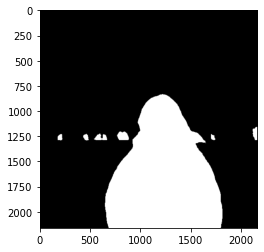

(1440, 1440)


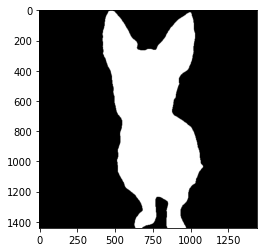

(1281, 1920)


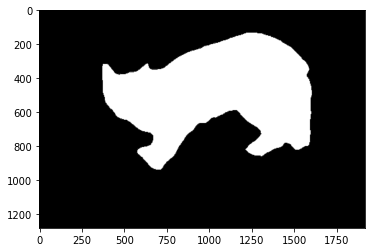

In [14]:
# output의 픽셀 별로 색상이 seg_color와 같다면 1(True), 다르다면 0(False)
seg_map1 = np.all(output1==seg_color1, axis=-1)
print(seg_map1.shape)
plt.imshow(seg_map1, cmap='gray')
plt.show()

seg_map2 = np.all(output2==seg_color2, axis=-1)
print(seg_map2.shape)
plt.imshow(seg_map2, cmap='gray')
plt.show()

seg_map3 = np.all(output3==seg_color3, axis=-1)
print(seg_map3.shape)
plt.imshow(seg_map3, cmap='gray')
plt.show()

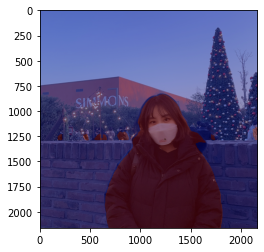

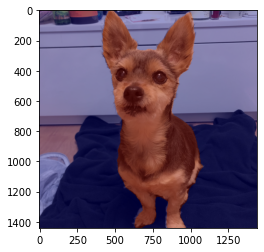

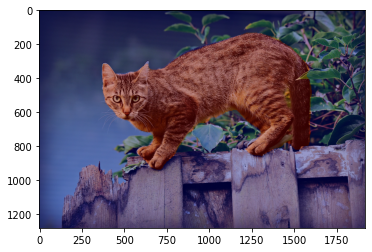

In [15]:
me_show = me_orig.copy()

# True과 False인 값을 각각 255과 0으로 바꿔줍니다
me_mask = seg_map1.astype(np.uint8) * 255

# 255와 0을 적당한 색상으로 바꿔봅니다
color_mask1 = cv2.applyColorMap(me_mask, cv2.COLORMAP_JET)

# 원본 이미지와 마스트를 적당히 합쳐봅니다
# 0.6과 0.4는 두 이미지를 섞는 비율입니다.
me_show = cv2.addWeighted(me_show, 0.6, color_mask1, 0.4, 0.0)

plt.imshow(cv2.cvtColor(me_show, cv2.COLOR_BGR2RGB))
plt.show()


dog_show = dog_orig.copy()

# True과 False인 값을 각각 255과 0으로 바꿔줍니다
dog_mask = seg_map2.astype(np.uint8) * 255

# 255와 0을 적당한 색상으로 바꿔봅니다
color_mask2 = cv2.applyColorMap(dog_mask, cv2.COLORMAP_JET)

# 원본 이미지와 마스트를 적당히 합쳐봅니다
# 0.6과 0.4는 두 이미지를 섞는 비율입니다.
dog_show = cv2.addWeighted(dog_show, 0.6, color_mask2, 0.4, 0.0)

plt.imshow(cv2.cvtColor(dog_show, cv2.COLOR_BGR2RGB))
plt.show()


cat_show = cat_orig.copy()

# True과 False인 값을 각각 255과 0으로 바꿔줍니다
cat_mask = seg_map3.astype(np.uint8) * 255

# 255와 0을 적당한 색상으로 바꿔봅니다
color_mask3 = cv2.applyColorMap(cat_mask, cv2.COLORMAP_JET)

# 원본 이미지와 마스트를 적당히 합쳐봅니다
# 0.6과 0.4는 두 이미지를 섞는 비율입니다.
cat_show = cv2.addWeighted(cat_show, 0.6, color_mask3, 0.4, 0.0)

plt.imshow(cv2.cvtColor(cat_show, cv2.COLOR_BGR2RGB))
plt.show()

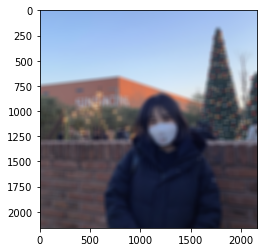

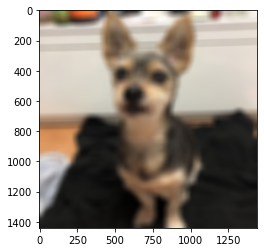

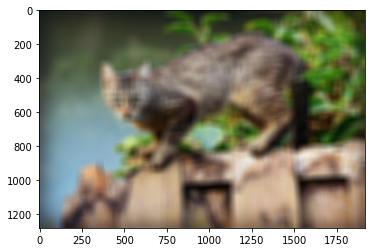

In [17]:
me_orig_blur = cv2.blur(me_orig, (50,50))  
plt.imshow(cv2.cvtColor(me_orig_blur, cv2.COLOR_BGR2RGB))
plt.show()

dog_orig_blur = cv2.blur(dog_orig, (50,50))  
plt.imshow(cv2.cvtColor(dog_orig_blur, cv2.COLOR_BGR2RGB))
plt.show()

cat_orig_blur = cv2.blur(cat_orig, (50,50))  
plt.imshow(cv2.cvtColor(cat_orig_blur, cv2.COLOR_BGR2RGB))
plt.show()

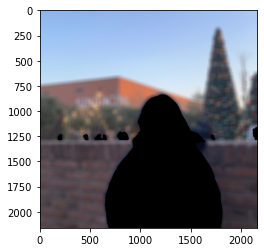

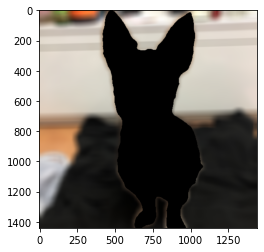

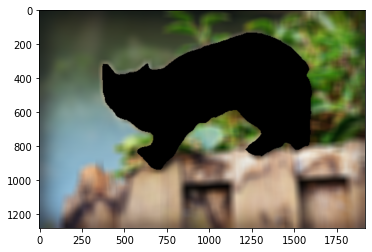

In [18]:
me_mask_color = cv2.cvtColor(me_mask, cv2.COLOR_GRAY2BGR)
me_bg_mask = cv2.bitwise_not(me_mask_color)
me_bg_blur = cv2.bitwise_and(me_orig_blur, me_bg_mask)
plt.imshow(cv2.cvtColor(me_bg_blur, cv2.COLOR_BGR2RGB))
plt.show()

dog_mask_color = cv2.cvtColor(dog_mask, cv2.COLOR_GRAY2BGR)
dog_bg_mask = cv2.bitwise_not(dog_mask_color)
dog_bg_blur = cv2.bitwise_and(dog_orig_blur, dog_bg_mask)
plt.imshow(cv2.cvtColor(dog_bg_blur, cv2.COLOR_BGR2RGB))
plt.show()

cat_mask_color = cv2.cvtColor(cat_mask, cv2.COLOR_GRAY2BGR)
cat_bg_mask = cv2.bitwise_not(cat_mask_color)
cat_bg_blur = cv2.bitwise_and(cat_orig_blur, cat_bg_mask)
plt.imshow(cv2.cvtColor(cat_bg_blur, cv2.COLOR_BGR2RGB))
plt.show()

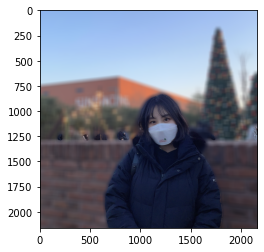

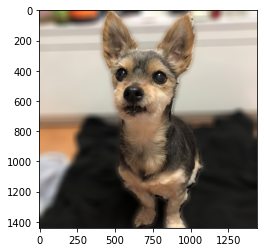

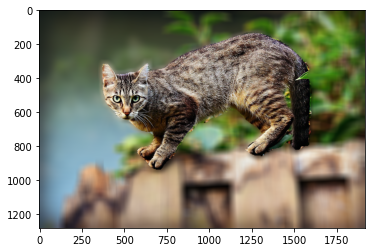

In [19]:
me_concat = np.where(me_mask_color==255, me_orig, me_bg_blur)
plt.imshow(cv2.cvtColor(me_concat, cv2.COLOR_BGR2RGB))
plt.show()

dog_concat = np.where(dog_mask_color==255, dog_orig, dog_bg_blur)
plt.imshow(cv2.cvtColor(dog_concat, cv2.COLOR_BGR2RGB))
plt.show()

cat_concat = np.where(cat_mask_color==255, cat_orig, cat_bg_blur)
plt.imshow(cv2.cvtColor(cat_concat, cv2.COLOR_BGR2RGB))
plt.show()

In [41]:
cv2.imwrite("me_concat.jpg", me_concat)
cv2.imwrite("dog_concat.jpg", dog_concat)
cv2.imwrite("cat_concat.jpg", cat_concat)

True

# 2. 크로마키 사진 만들기

(1080, 1920, 3)


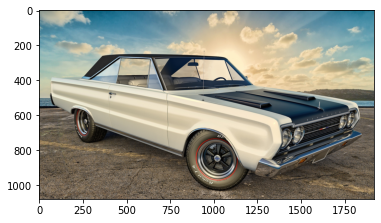

(1080, 1920, 3)


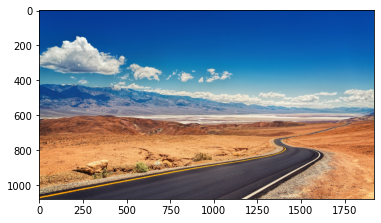

In [29]:
car_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/car.jpg'  
car_orig = cv2.imread(car_path) 

print(car_orig.shape)
plt.imshow(cv2.cvtColor(car_orig, cv2.COLOR_BGR2RGB))
plt.show()

road_path = os.getenv('HOME')+'/aiffel/human_segmentation/images/road.jpg'  
road_orig = cv2.imread(road_path) 

print(road_orig.shape)
plt.imshow(cv2.cvtColor(road_orig, cv2.COLOR_BGR2RGB))
plt.show()

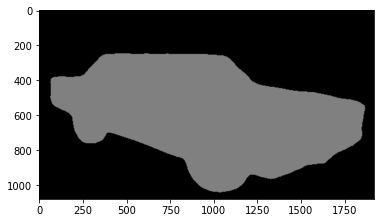

In [21]:
segvalues4, output4 = model.segmentAsPascalvoc(car_path)

plt.imshow(output4)
plt.show()

In [23]:
colormap[7]

array([128, 128, 128])

In [25]:
seg_color4 = (128, 128, 128)

(1080, 1920)


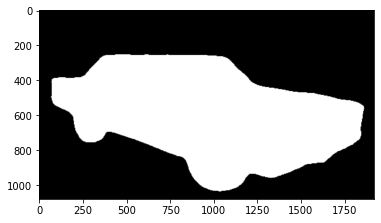

In [35]:
seg_map4 = np.all(output4==seg_color4, axis=-1)
print(seg_map4.shape)
plt.imshow(seg_map4, cmap='gray')
plt.show()

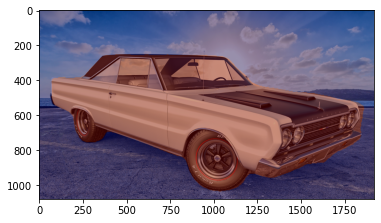

In [30]:
car_show = car_orig.copy()

# True과 False인 값을 각각 255과 0으로 바꿔줍니다
car_mask = seg_map4.astype(np.uint8) * 255

# 255와 0을 적당한 색상으로 바꿔봅니다
color_mask4 = cv2.applyColorMap(car_mask, cv2.COLORMAP_JET)

# 원본 이미지와 마스트를 적당히 합쳐봅니다
# 0.6과 0.4는 두 이미지를 섞는 비율입니다.
car_show = cv2.addWeighted(car_show, 0.6, color_mask4, 0.4, 0.0)

plt.imshow(cv2.cvtColor(car_show, cv2.COLOR_BGR2RGB))
plt.show()

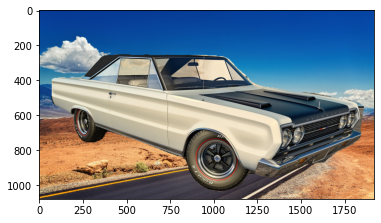

In [37]:
# img_concat = np.where(img_mask_color==255, img_orig, img_bg_blur)
# plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
# plt.show()

car_mask_color = cv2.cvtColor(car_mask, cv2.COLOR_GRAY2BGR)
car_concat = np.where(car_mask_color==255, car_orig, road_orig)
plt.imshow(cv2.cvtColor(car_concat, cv2.COLOR_BGR2RGB))
plt.show()

In [42]:
cv2.imwrite("car_concat.jpg", car_concat)

True

# 3. 문제점

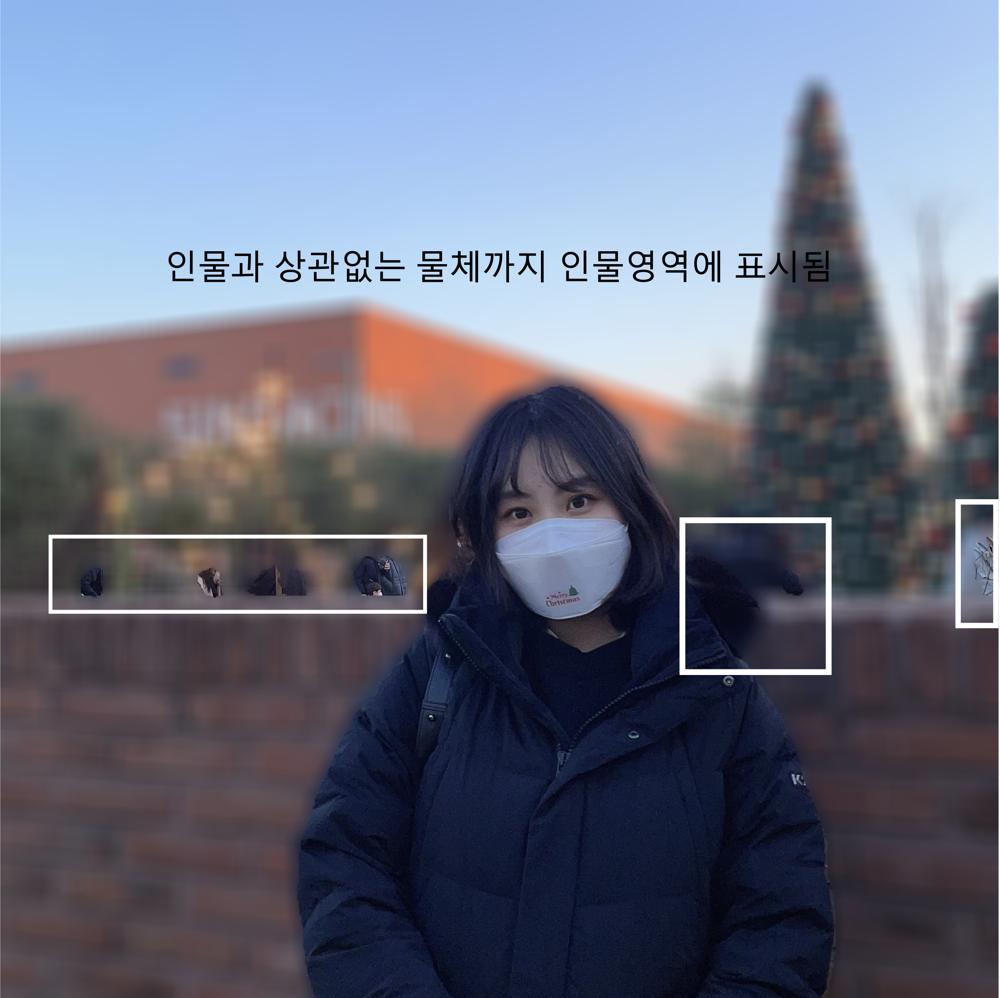

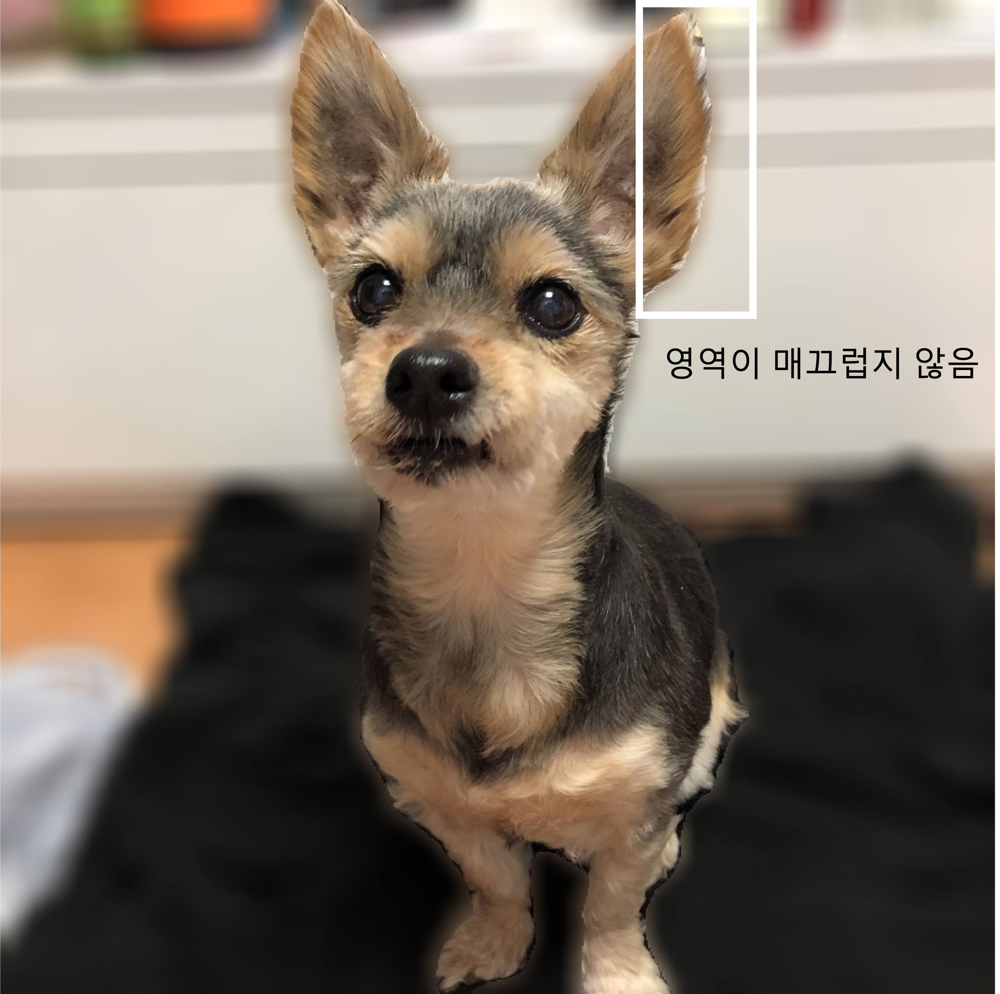

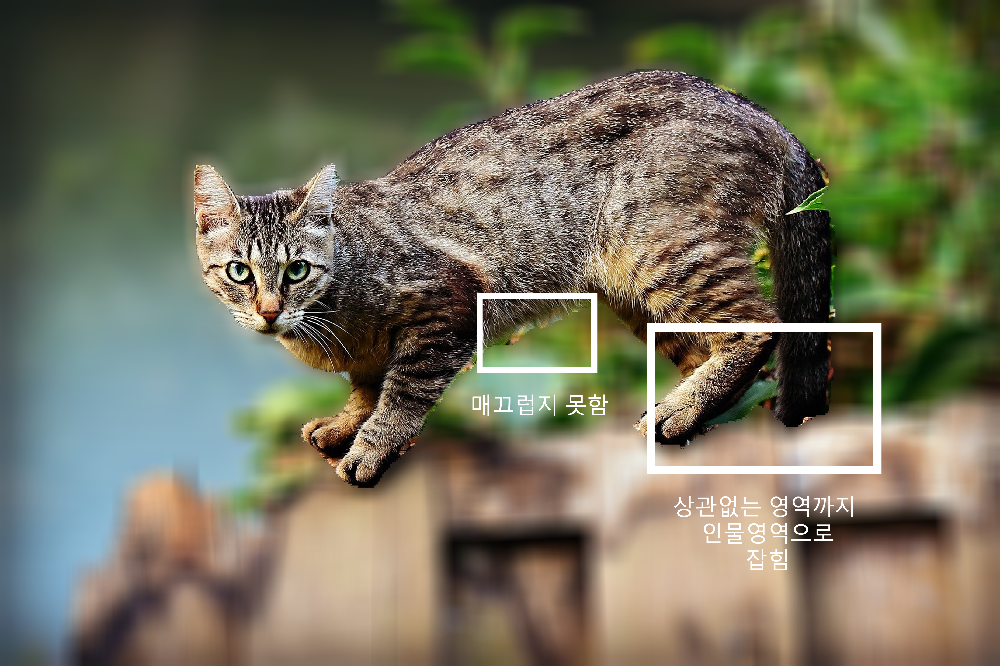

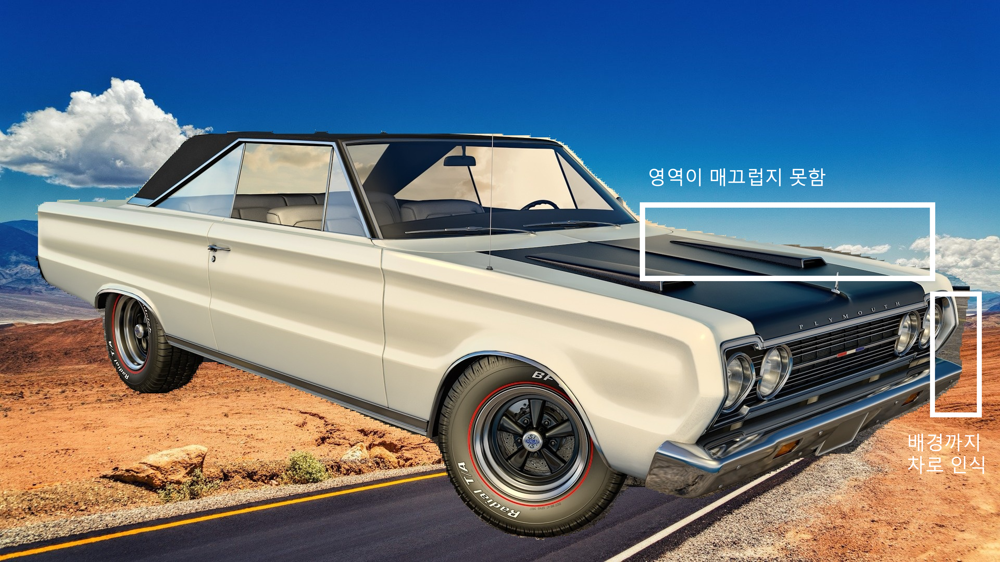

# 4. 해결방안

정확한 영역 선정과 경계가 매끄럽지 못한 부분에 대한 해결 방안

**Mask R-CNN**

**PointRend**

https://doooob.tistory.com/79

특질량 맵의 픽셀 값의 분포에 따라 계산 대상을 선택하는 샘플링의 밀도를 바꾸는 것

1. Point Selection Strategy: 몇 개의 포인트를 선책하여 예측하는 것, 고해상도로 변환한 후의 계산량을 제한하여 계산량을 억제한다.

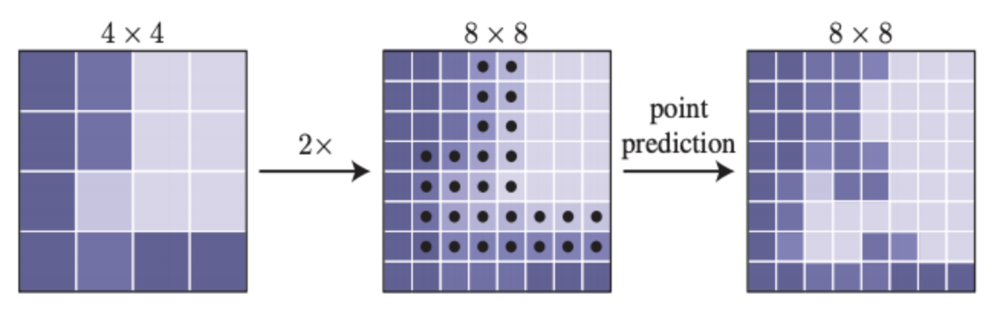

2. Point-wise Feature Representation: 선택된 포인트마다 Bi-Linear 보간법을 이용하여 특징량을 추출한다.

3. Point Head: 포인트마다 추출된 특징량으로부터 라벨을 예측하도록 학습한 소형 신경망

# 5. 회고
cv가 직관적이고 재밌다는 걸 느끼는 요즘이다.

특히나 우리집 강아지 삼순이 사진으로 작업하니 재미는 2배!

이번 익스에서는 해결방안에 대해서 생각을 오래했는데, 창의성이 부족한 탓도 있어 구글링하는데 어려웠고, 아직 모르는 내용도 너무 많아 논문이나 저널을 읽어도 모르겠더라.. 그와중에 Mask R-CNN이라는 걸 찾았는데 정확하게 모든 걸 이해하지는 못했지만 Fast R-CNN에서 Mask R-CNN까지의 변천사와 장단점을 알 수 있어서 좋았다. PointRend는 흥미로웠다. 얼른 용어들이 익숙해지고 모델과 클래스 등의 체계가 머리에 잡혀서 한글을 읽는 느낌이 났으면 좋겠다..^ㅠ^(지금은 읽어도 한글인지 영어인지 모르는 수준)